# Projecting Train Volumes onto Track Segments

This notebook will take the train volumes estimated from TrainVolumes.ipynb and project them onto the track segments using geospatial transformations. Two different methods were tried:
1. Assigning tracks the volumes of the closest traffic signal point
2. An iterative process where the first tracks are assigned the volumes of the closest traffic signal points and then the tracks segments closest to those points are assigned the volumes of the next closest points. This process is repeated until all tracks have volumes assigned. This method looks better, but is quite slow.


## Method 1: Assigning tracks the volumes of the closest traffic signal point

In [15]:
import duckdb
con = duckdb.connect()
con.sql("LOAD spatial;")

# Create a view of the track segments
track_segments = con.sql("""
    SELECT rrowner1, yardname, passenger::bool as passenger, tracks, miles,
           ST_GeomFromText(GEOMETRY) as geometry
    FROM 'data/Indiana_Rail_Network_Lines.csv'
""")

# Create a view of the train points
train_points = con.sql("""
    -- Convert train volume locations to geometry points
    SELECT location, annual_estimate,
           ST_Point(longitude, latitude) as geometry
    FROM 'data/train_volumes.parquet'
""")

# Find the closest train point for each track segment
closest_points = con.sql("""
    SELECT t.rrowner1, t.yardname, t.passenger, t.tracks, t.miles, t.geometry as track_geometry,
           p.annual_estimate,
           ROW_NUMBER() OVER (
               PARTITION BY t.geometry
               ORDER BY ST_Distance(ST_Centroid(t.geometry), p.geometry)
           ) as rn
    FROM track_segments t
    CROSS JOIN train_points p
""")

# Select the closest train point for each track segment
track_segment_volumes = con.sql("""
    SELECT 
        rrowner1, yardname, passenger, tracks, miles, 
        ST_AsText(track_geometry) as geometry,  -- Convert to WKT string
        annual_estimate
    FROM closest_points
    WHERE rn = 1
""").df()

track_segment_volumes

,rrowner1,yardname,passenger,tracks,miles,geometry,annual_estimate
0,TPW,None,False,0,0.022186,MULTILINESTRING ((-86.43136233899997 40.734783...,260
1,CN,None,False,0,0.026340,MULTILINESTRING ((-87.37697436999997 41.617643...,16016
2,WBCR,None,False,0,0.215670,MULTILINESTRING ((-85.35549417199996 40.690944...,624
3,NS,None,False,0,0.117972,MULTILINESTRING ((-86.84964665399997 40.375542...,260
4,CSXT,None,False,1,0.499567,MULTILINESTRING ((-86.05083068999994 39.805711...,5512
...,...,...,...,...,...,...,...
7360,CN,KIRK,False,0,0.011831,MULTILINESTRING ((-87.35833768799995 41.613675...,16016
7361,IHB,None,False,2,0.328923,MULTILINESTRING ((-87.46188020499994 41.618037...,1092
7362,CSXT,CURTIS,False,0,0.206508,MULTILINESTRING ((-87.37803826599998 41.618616...,16016
7363,IHB,None,False,2,0.140683,MULTILINESTRING ((-87.46386505799995 41.604301...,1092


In [16]:
# Also need to materialize the train point volumes
train_points_volumes = con.sql("SELECT * FROM 'data/train_volumes.parquet'").df()
train_points_volumes

,location,latitude,longitude,annual_estimate
0,SR 67 at Mooresville Rd,39.646620,-86.329085,104
1,US 50 & Agrico,38.958050,-85.862600,156
2,"SR 67 & Mendenhall Rd, Heathrow Way",39.679729,-86.288353,208
3,US 31(MORTON) @ SR 44(JEFFERSON),39.480141,-86.064060,208
4,US 50 & Stevens Way,38.958210,-85.837680,208
...,...,...,...,...
62,US 33 & Green Road,41.602095,-85.867745,20904
63,SR 933(Lincolnway E.) @ Russell Ave.,41.657750,-86.210594,21424
64,SR 933 (Lincolnway E.) @ Ash Rd.,41.664108,-86.061065,22100
65,US 33 & CR 15,41.626728,-85.906687,22568


Now that we have the volumes assigned to the track segments, we can plot them to see how they look.

In [18]:
import geopandas as gpd
import folium
from shapely import wkt
from shapely.geometry import MultiLineString
from branca.colormap import LinearColormap  # Add this import
import geopandas as gpd
import folium
from shapely import wkt
from shapely.geometry import MultiLineString

def plot_volumes(points, tracks):
    # Convert WKT strings to geometry objects if not already
    if not isinstance(tracks['geometry'].iloc[0], MultiLineString):
        tracks['geometry'] = tracks['geometry'].apply(wkt.loads)

    # Create a new map centered on Indiana
    m = folium.Map(location=[39.8283, -86.2789], zoom_start=7)

    # Create color map for volumes
    min_volume = points['annual_estimate'].min()
    max_volume = points['annual_estimate'].max()
    colormap = LinearColormap(
        colors=['green', 'yellow', 'orange', 'red'],
        vmin=min_volume,
        vmax=max_volume,
        caption='Annual Train Volume Estimate'
    )

    for idx, row in tracks.iterrows():
        for line in row['geometry'].geoms:
            coords = [[y, x] for x, y in line.coords]
            folium.PolyLine(
                locations=coords,
                color=colormap(row['annual_estimate']),
                weight=3,
                opacity=0.8,
                popup=f"""
                Owner: {row['rrowner1']}<br>
                Annual Volume: {row['annual_estimate']}<br>
                Miles: {row['miles']}<br>
                Passenger: {row['passenger']}<br>
                Tracks: {row['tracks']}<br>
                Yard: {row['yardname']}
                """
            ).add_to(m)

    # Add train volume points with circle markers
    for idx, row in points.iterrows():
        color = colormap(row['annual_estimate'])
        folium.CircleMarker(
            location=[row['latitude'], row['longitude']],
            radius=7,
            popup=f"Location: {row['location']}<br>Annual Estimate: {row['annual_estimate']}",
            color=color,
            fill=True,
            fill_color=color,
            fill_opacity=0.7
        ).add_to(m)
        
    colormap.add_to(m)
    custom_css = """
    <style>
        .legend {
            position: absolute;
            top: 0px;
            right: 100px;
            transform: rotate(-90deg);
            transform-origin: top right;
            background-color: rgba(255, 255, 255, 0.9);  /* White background with 90% opacity */
            padding: 10px;  /* Add padding around the legend */
            border: 1px solid #ccc;  /* Light gray border */
            border-radius: 4px;  /* Rounded corners */
            box-shadow: 0 1px 3px rgba(0,0,0,0.1);  /* Subtle shadow */
        }
        /* Make the text darker for better contrast */
        .legend .caption {
            color: #333;
            font-weight: 500;
        }
    </style>
    """
    m.get_root().html.add_child(folium.Element(custom_css))
    return m

plot_volumes(train_points_volumes, track_segment_volumes)

This dosen't do a great job and is obviously wrong in some splots:

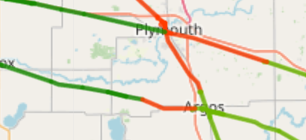

# Try with multiple iterations

In [19]:
import duckdb
con = duckdb.connect()
con.sql("LOAD spatial;")

con.sql("""
    DROP TABLE IF EXISTS all_track_segments;
    CREATE TABLE all_track_segments AS
    SELECT 
        ROW_NUMBER() OVER () as segment_id,
        rrowner1, yardname, passenger::bool as passenger, tracks, miles,
        ST_GeomFromText(GEOMETRY) as geometry
    FROM 'data/Indiana_Rail_Network_Lines.csv';

    DROP TABLE IF EXISTS train_points;
    CREATE TABLE train_points AS
    SELECT location, annual_estimate,
           ST_Point(longitude, latitude) as geometry
    FROM 'data/train_volumes.parquet'
""")

In [20]:
# First iteration: Assign volumes from traffic signals to closest track
con.sql("""
    DROP TABLE IF EXISTS track_with_volumes;
    CREATE TABLE track_with_volumes AS
    SELECT DISTINCT ON (t.geometry)  -- Take only the closest point for each track
        t.*,
        p.annual_estimate
    FROM all_track_segments t
    CROSS JOIN train_points p
    WHERE ST_Distance(t.geometry, p.geometry) < 0.001  -- Add distance threshold
    ORDER BY t.segment_id
""")

#track_segment_volumes = duckdb.sql("select * REPLACE(ST_AsText(geometry) as geometry) FROM initial_assignments").df()
con.sql("SELECT * FROM track_with_volumes").df()

,segment_id,rrowner1,yardname,passenger,tracks,miles,geometry,annual_estimate
0,299,LIRC,None,False,1,0.619007,"[4, 4, 0, 0, 0, 0, 0, 0, 32, 129, 171, 194, 1,...",3276
1,300,LIRC,None,False,1,0.613696,"[4, 4, 0, 0, 0, 0, 0, 0, 68, 129, 171, 194, 29...",3276
2,309,KBSR,None,False,1,2.689108,"[4, 4, 0, 0, 0, 0, 0, 0, 177, 234, 173, 194, 2...",260
3,310,KBSR,None,False,1,4.374098,"[4, 4, 0, 0, 0, 0, 0, 0, 54, 15, 174, 194, 83,...",260
4,333,INRD,None,False,1,2.625358,"[4, 4, 0, 0, 0, 0, 0, 0, 77, 95, 174, 194, 71,...",208
...,...,...,...,...,...,...,...,...
63,7064,NS,ELKHART,True,2,0.079942,"[4, 4, 0, 0, 0, 0, 0, 0, 15, 32, 172, 194, 154...",22100
64,7123,CSXT,None,False,2,0.918194,"[4, 4, 0, 0, 0, 0, 0, 0, 76, 224, 171, 194, 11...",5512
65,7185,NS,ELKHART,True,2,0.120575,"[4, 4, 0, 0, 0, 0, 0, 0, 69, 31, 172, 194, 185...",22100
66,7200,NS,None,False,1,0.099447,"[4, 4, 0, 0, 0, 0, 0, 0, 238, 113, 174, 194, 1...",4732


In [21]:
remaining = 1
distance_threshold = 0.01

while remaining > 0:
    remaining_previous = int(remaining) # convert to int so its not a pointer

    # Get remaining segments
    remaining_segments = con.sql("""
        SELECT *
        FROM all_track_segments
        WHERE segment_id NOT IN (
            SELECT segment_id FROM track_with_volumes
        )
    """)

    remaining = con.sql('SELECT COUNT(*) FROM remaining_segments').fetchone()[0]
    print(f"Remaining segments: {remaining}")

    if remaining_previous == remaining:
        print(f"Increasing distance threshold to {distance_threshold * 10}")
        distance_threshold *= 10

    # Join track_with_volumes to remaining_segments
    new_segments = con.sql(f"""
        WITH closest AS (
            SELECT r.*, t.annual_estimate,
                ROW_NUMBER() OVER (PARTITION BY r.segment_id ORDER BY ST_Distance(r.geometry, t.geometry)) as rn
            FROM remaining_segments r
            CROSS JOIN track_with_volumes t
            WHERE ST_Distance(r.geometry, t.geometry) < {distance_threshold}
        )
        SELECT * EXCLUDE rn FROM closest WHERE rn = 1
    """)


    con.sql("INSERT INTO track_with_volumes SELECT * FROM new_segments")

Remaining segments: 7297
Remaining segments: 6421
Remaining segments: 5755
Remaining segments: 5432
Remaining segments: 4983
Remaining segments: 4475
Remaining segments: 4013
Remaining segments: 3636
Remaining segments: 3362
Remaining segments: 3072
Remaining segments: 2821
Remaining segments: 2515
Remaining segments: 2170
Remaining segments: 1901
Remaining segments: 1636
Remaining segments: 1389
Remaining segments: 1200
Remaining segments: 1004
Remaining segments: 858
Remaining segments: 720
Remaining segments: 607
Remaining segments: 493
Remaining segments: 408
Remaining segments: 349
Remaining segments: 307
Remaining segments: 271
Remaining segments: 255
Remaining segments: 228
Remaining segments: 216
Remaining segments: 197
Remaining segments: 177
Remaining segments: 164
Remaining segments: 142
Remaining segments: 127
Remaining segments: 101
Remaining segments: 97
Remaining segments: 90
Remaining segments: 80
Remaining segments: 68
Remaining segments: 63
Remaining segments: 62
Rema

In [23]:
track_segment_volumes = con.sql("SELECT * REPLACE(ST_AsText(geometry) as geometry) FROM track_with_volumes").df()

# Plot
plot_volumes(train_points_volumes, track_segment_volumes)

In [26]:
track_segment_volumes.to_csv('data/track_segment_volumes.csv', index=False)
track_segment_volumes.head(3)

,segment_id,rrowner1,yardname,passenger,tracks,miles,geometry,annual_estimate
0,299,LIRC,None,False,1,0.619007,MULTILINESTRING ((-85.75219166999995 38.406361...,3276
1,300,LIRC,None,False,1,0.613696,MULTILINESTRING ((-85.75235658999998 38.415246...,3276
2,309,KBSR,None,False,1,2.689108,MULTILINESTRING ((-86.95838045399995 40.446606...,260
